# 수집된 데이터에 대한 통계 분석
* 데이터 
> 2017년 12월 1일부터 2018년 2월 1일까지 63일간 [네이버](http://www.naver.com)와 [다음](http://www.daum.net)의 랭킹뉴스와 뉴스의 댓글을 크롤링함.

In [1]:
import os
import pandas as pd 
from glob import glob
import sys
import time, re, pickle, itertools
import urllib3, json
sys.path.append('~/Documents/GitHub/Private_Project/personal_project/')
import re
from operator import itemgetter
import html
from collections import Counter
import numpy as np
import matplotlib.pyplot as plt
import matplotlib as mpl
import chat_bot as cb
import Database_Handler as dh
from datetime import datetime
import seaborn as sns
import functools
%matplotlib inline

In [2]:
def Round_Max_Number(numList):
    maxNum = max(numList)
    maxNumCipher = len(str(maxNum))-1
    x1 = maxNum / (10**maxNumCipher)
    import math
    return 10**maxNumCipher, math.ceil(x1)*(10**maxNumCipher)

In [3]:
def Plotting_Spider(categories, values, title):
    from math import pi
    n = len(categories)
    
    values += values[:1]
    angles = [a / float(n) * 2 * pi for a in range(n)]
    angles += angles[:1]
    ax = plt.subplot(111, polar = True)

    plt.title(title)

    plt.xticks(angles[:-1], categories,
               color = 'black', size = 8)

    ax.set_rlabel_position(0)
    
    x = Round_Max_Number(values)
    ticks = list(range(x[0], x[1]+1, x[0]))
    ticks2 = list(map(lambda x: str(x), ticks))
    
    plt.yticks(ticks, ticks2,
              color = 'grey', size = 7)
    plt.ylim(0,50)

    ax.plot(angles, values, linewidth = 1, linestyle = 'solid')

    ax.fill(angles, values, 'b', alpha = 0.1)


# 다음 (Daum)

In [4]:
file = './data/pre_data/stastics/for_statistics_daum_from_mongodb.pickled'
dataDict_daum = pickle.load(open(file,'rb'))

In [5]:
df_daum = pd.DataFrame.from_dict(dataDict_daum, orient='index')
df_daum['date'] = pd.to_datetime(df_daum['date']).dt.date
df_daum.reset_index(inplace = True)
df_daum.rename(columns={'index':'id'}, inplace=True)
print (df_daum.shape)
df_daum.head()

(9372, 11)


,id,category,date,press,number_of_comment,number_of_crawled_comment,rank,title,mainText,keywords,extracted_keywords
0,5a2a61bf588c13481c229d1e,뉴스,2017-12-07,세계일보,1093,911,1,"""밤이 무섭다""..비아그라 공장 연기에 남성들 부작용 호소","주민들은 공장에서 배출된 연기가 '남성이 매우 건강해지는 부작용'을 일으킨다며, ...","[부작용, 비아그라, 아일랜드]","{부작용, 건강, 남성들, 연기, 지역, 공장, 세보 효과}"
1,5a2a61bf588c13481c229d1f,뉴스,2017-12-07,헬스조선,603,386,2,식후 커피·늦은 양치질..점심식사 후 하면 안 좋은 습관 3가지,점심식사를 마친 후 후식으로 커피를 마시는 사람들이 많다. 실제로 직장이 밀집돼 ...,"[커피, 낮잠, 음식물]","{식후, 커피, 치아, 건강, 디스크, 낮잠, 입냄새, 철분, 자세, 점심 식사}"
2,5a2a61bf588c13481c229d20,뉴스,2017-12-07,연합뉴스,1067,811,3,"'십년지기 생매장' 진짜 이유는..""'청부 통정' 알려질까 봐""",(성남=연합뉴스) 최해민 기자 = 십년지기 지인을 산 채로 묻어 살해한 50대 여...,"[살인혐의, 철원, 검찰송치]","{지인, 철원, 앙심, 범행, 진술, 아들, 남편, 주변, 경찰, 성관계}"
3,5a2a61bf588c13481c229d21,뉴스,2017-12-07,헤럴드경제,418,369,4,"신영자, 억 소리나는 갑질","신영자, 적용안된 혐의→검찰 상고에서 인정\n신영자, 얼마를 어떻게 받았나 [헤럴...","[신영자, 갑질, 롯데백화점]","{신영자 이사장, 유통업체, 징역, 롯데, 네이처리퍼블릭, 검찰, 매장, 혐의}"
4,5a2a61bf588c13481c229d22,뉴스,2017-12-07,연합뉴스,434,368,5,"""배신하지마"" 20대女 살인 피의자 유치장서 공범 남친에 쪽지",(청주=연합뉴스) 이승민 기자 = 지난 9월 청주의 한 하천에서 20대 여성을 둔기...,"[공범, 살인, 과자]","{남자친구, 범행, 폭행, 과자, 쪽지, 유치장, 경찰, 혐의}"


## 1. 뉴스에 대한 통계분석

In [6]:
start = df_daum['date'].min()
end = df_daum['date'].max()
print ('수집된 날짜 : {} ~ {}, {}일간'.format(start.strftime('%Y-%m-%d'), end.strftime('%Y-%m-%d'), (end-start).days+1))
count = len(df_daum['press'].unique())
print ('number of news in naver : {} '.format(df_daum.shape[0]))
print ('다음 뉴스에 등록된 언론사의 수 : {}'.format(156))
print ('뉴스 기사가 한번이라도 네이버의 랭킹뉴스에 등록된 언론사의 수 : {}, 전체의 {:0.1f}%'.format(count, count/156*100))

수집된 날짜 : 2017-12-01 ~ 2018-02-01, 63일간
number of news in naver : 9372 
다음 뉴스에 등록된 언론사의 수 : 156
뉴스 기사가 한번이라도 네이버의 랭킹뉴스에 등록된 언론사의 수 : 108, 전체의 69.2%


### DAUM 뉴스에 등록된 언론사 목록
![사진](./daum_news.png )

#### 다음에 등록된 언론사의 분류에 확인해보자

In [7]:
pressdict = pickle.load(open('./data/daum_enrolled_press_by_category.pickled','rb'))

In [8]:
enrolledPress = list()
for idx in pressdict:
    enrolledPress.append((idx.strip(), len(pressdict[idx])))
enrolledPress = pd.DataFrame(enrolledPress)
enrolledPress.rename(columns={0:'category',1:'count'},inplace = True)
enrolledPress.set_index('category', inplace = True)
enrolledPress

,count
category,
종합,14
경제,10
온라인.인터넷,6
TV.동영상,12
스포츠.연예,24
스포츠 전문지,30
IT,8
매거진,41
전문지,7


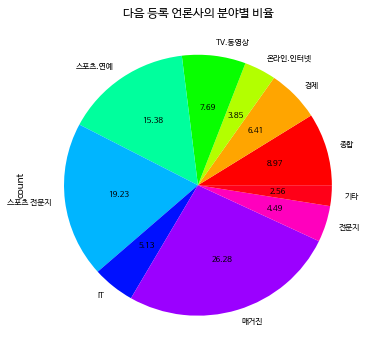

In [9]:
enrolledPress['count'].plot.pie(autopct='%.2f', colormap = plt.get_cmap('hsv'), fontsize=8, figsize=(6, 6),title='다음 등록 언론사의 분야별 비율')

* 매거진이 전체의 26%로 가장 많으며, 그 다음은 스포츠 전문지로 19%, 그리고 그다음이 스포츠.연예 분야로 15%이다. 
> 연예 또는 스포츠와 관련된 언론사가 34%로 가장 많다

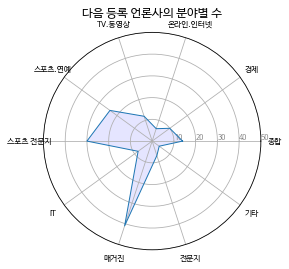

In [10]:
Plotting_Spider(categories=enrolledPress.index.values, values=enrolledPress['count'].values.flatten().tolist(), title='다음 등록 언론사의 분야별 수')

### 수집기간동안 네이버 랭킹뉴스에 한건이라도 나온 언론사

In [11]:
count_by_press = df_daum.groupby('press')['id'].count().sort_values(ascending=False)
pressIn_ranked = list()
cat_press_in_ranked = dict()
for idx in count_by_press.index:
    for key in pressdict:
        if idx in pressdict[key]:
            pressIn_ranked.append(key.strip())
            cat_press_in_ranked[idx] = key.strip()
            break
pressIn_ranked = Counter(pressIn_ranked)
pressIn_ranked = pd.DataFrame.from_dict(pressIn_ranked,orient='index')
pressIn_ranked.rename(columns={0:'count_in_ranked'}, inplace = True)

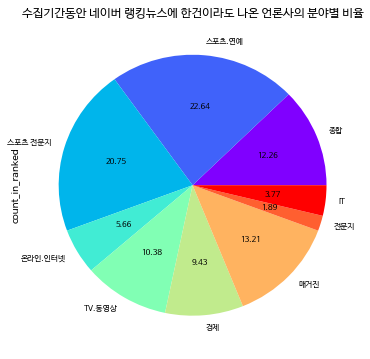

In [12]:
pressIn_ranked['count_in_ranked'].plot.pie(autopct='%.2f', fontsize=8,colormap = plt.get_cmap('rainbow'), figsize=(6, 6), title = '수집기간동안 네이버 랭킹뉴스에 한건이라도 나온 언론사의 분야별 비율')

In [13]:
pressIn_ranked

,count_in_ranked
종합,13
스포츠.연예,24
스포츠 전문지,22
온라인.인터넷,6
TV.동영상,11
경제,10
매거진,14
전문지,2
IT,4


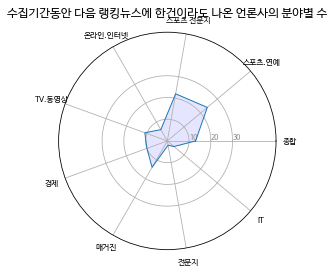

In [15]:
Plotting_Spider(categories= pressIn_ranked.index.values, values=pressIn_ranked['count_in_ranked'].values.flatten().tolist(), title='수집기간동안 다음 랭킹뉴스에 한건이라도 나온 언론사의 분야별 수')

In [16]:
total_and_ranked = pd.merge(enrolledPress, pressIn_ranked, left_index=True, right_index=True, how='outer')
total_and_ranked.fillna(0,inplace=True)
total_and_ranked['count_in_ranked'] = total_and_ranked['count_in_ranked'].astype(int)
total_and_ranked['percentage'] = total_and_ranked['count_in_ranked']/total_and_ranked['count'] * 100
total_and_ranked = total_and_ranked.sort_values(by='percentage', ascending=False)
total_and_ranked.T

,경제,스포츠.연예,온라인.인터넷,종합,TV.동영상,스포츠 전문지,IT,매거진,전문지,기타
count,10.0,24.0,6.0,14.000000,12.000000,30.000000,8.0,41.000000,7.000000,4.0
count_in_ranked,10.0,24.0,6.0,13.000000,11.000000,22.000000,4.0,14.000000,2.000000,0.0
percentage,100.0,100.0,100.0,92.857143,91.666667,73.333333,50.0,34.146341,28.571429,0.0


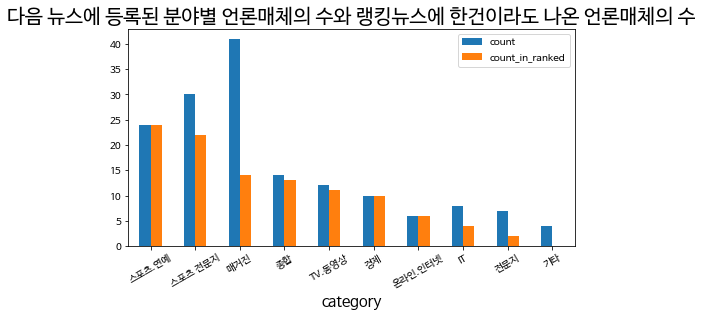

In [17]:
f1 = plt.figure(figsize=(8,4))
plt.title('다음 뉴스에 등록된 분야별 언론매체의 수와 랭킹뉴스에 한건이라도 나온 언론매체의 수', color='black',fontsize=20)
total_and_ranked[['count','count_in_ranked']].sort_values(by='count_in_ranked', ascending=False).plot(kind='bar', ax=f1.gca())
plt.xticks(fontsize=10,rotation=30)
plt.yticks(fontsize=10)
plt.xlabel('category',fontsize=15)
plt.show()

### 일별 뉴스기사수

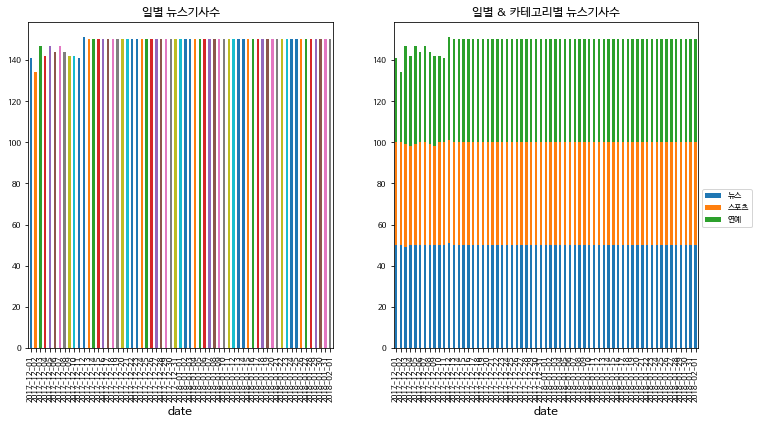

In [18]:
f1 = plt.figure(figsize=(12,6))
ax1 = f1.add_subplot(1, 2, 1)
plt.title('일별 뉴스기사수', color='black')
df_daum.groupby('date')['id'].count().plot(kind = 'bar',rot=90,ax=ax1)
plt.xticks(fontsize=8)
plt.yticks(fontsize=8)
plt.xlabel('date',fontsize=12)
ax2 = f1.add_subplot(1, 2, 2)
plt.title('일별 & 카테고리별 뉴스기사수', color='black')
df_daum.groupby(['date','category'])['id'].count().unstack().plot(kind='bar',stacked=True,ax=ax2)
plt.legend(loc='best', bbox_to_anchor=(1.0, 0.5),fontsize=8)
plt.xticks(fontsize=8)
plt.yticks(fontsize=8)
plt.xlabel('date',fontsize=12)
plt.show()

> * 총 4722개의 뉴스기사

### 언론사별 뉴스기사수

In [19]:
count_by_press = df_daum.groupby('press')['id'].count().sort_values(ascending=False)

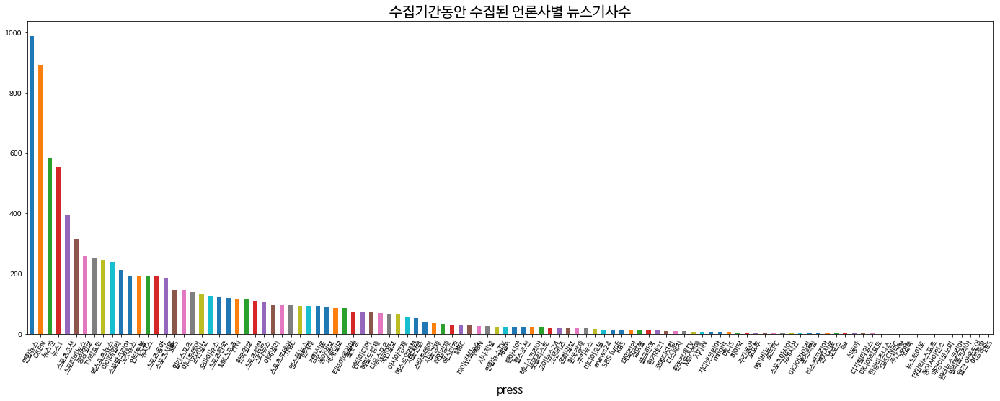

In [20]:
f1 = plt.figure(figsize=(24,8))
plt.title('수집기간동안 수집된 언론사별 뉴스기사수', color='black', fontsize= 20)
count_by_press.plot(kind='bar', rot=60,ax = f1.gca())
plt.xticks(fontsize=10)
plt.yticks(fontsize=10)
plt.xlabel('press',fontsize=15)
plt.show()

언론사 : 연합뉴스, 분야 : 종합
언론사 : OSEN, 분야 : 스포츠.연예
언론사 : 뉴스엔, 분야 : 스포츠.연예
언론사 : 뉴스1, 분야 : 종합
언론사 : 스포츠조선, 분야 : 스포츠.연예
언론사 : 스포티비뉴스, 분야 : 스포츠 전문지
언론사 : 중앙일보, 분야 : 종합
언론사 : TV리포트, 분야 : 스포츠.연예
언론사 : 엑스포츠뉴스, 분야 : 스포츠.연예
언론사 : 마이데일리, 분야 : 스포츠.연예
언론사 : 스포탈코리아, 분야 : 스포츠 전문지
언론사 : 노컷뉴스, 분야 : 온라인.인터넷
언론사 : 인터풋볼, 분야 : 스포츠 전문지
언론사 : 뉴시스, 분야 : 종합
언론사 : 스포츠동아, 분야 : 스포츠.연예
언론사 : 스포츠서울, 분야 : 스포츠.연예
언론사 : SBS, 분야 : TV.동영상
언론사 : 일간스포츠, 분야 : 스포츠.연예
언론사 : 머니투데이, 분야 : 경제
언론사 : 조선일보, 분야 : 종합
언론사 : 오마이뉴스, 분야 : 온라인.인터넷
언론사 : 스포츠한국, 분야 : 스포츠.연예
언론사 : MK스포츠, 분야 : 스포츠.연예
언론사 : YTN, 분야 : TV.동영상
언론사 : 한국일보, 분야 : 종합
언론사 : 스포츠경향, 분야 : 스포츠.연예
언론사 : 스타뉴스, 분야 : 스포츠.연예
언론사 : 이데일리, 분야 : 경제
언론사 : 스포츠투데이, 분야 : 스포츠.연예
언론사 : JTBC, 분야 : TV.동영상
언론사 : 엠스플뉴스, 분야 : 스포츠 전문지
언론사 : 한겨레, 분야 : 종합
언론사 : 경향신문, 분야 : 종합
언론사 : 동아일보, 분야 : 종합
언론사 : 세계일보, 분야 : 종합
언론사 : 티브이데일리, 분야 : 스포츠.연예
언론사 : 골닷컴, 분야 : 스포츠 전문지
언론사 : 엔터미디어, 분야 : 스포츠.연예
언론사 : 헤럴드경제, 분야 : 경제
언론사 : 다음스포츠, 분야 : 기타
언론사 : 국민일보, 분야 : 종합
언론사 : 아시아경제, 분야 : 경제
언론사 : 베스트일레븐, 분야 : 스포츠 전문지
언론사

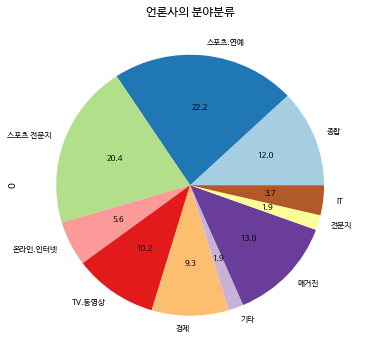

In [21]:
catis = list()
for idx in count_by_press.index:
    if idx in cat_press_in_ranked:
        catis.append(cat_press_in_ranked[idx])
        print ('언론사 : {}, 분야 : {}'.format(idx, cat_press_in_ranked[idx]))    
    else:
        catis.append('기타')
        print ('언론사 : {}, 분야 : {}'.format(idx, '기타'))    
catis = pd.DataFrame.from_dict(Counter(catis), orient='index')[0]
catis.plot.pie(autopct='%.1f',colormap = plt.get_cmap('Paired'), fontsize=8, figsize=(6, 6), title='언론사의 분야분류')

* 위의 목록에 존재하지 않는 언론사는 기타로 분류

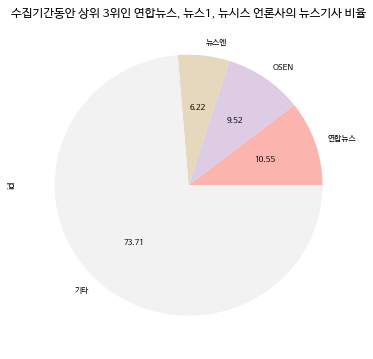

In [23]:
top3 = count_by_press[:3]
top3['기타'] = count_by_press.sum()-count_by_press[:3].sum()
top3.plot.pie(autopct='%.2f', fontsize=8, figsize=(6, 6),colormap = plt.get_cmap('Pastel1'), title = '수집기간동안 상위 3위인 연합뉴스, 뉴스1, 뉴시스 언론사의 뉴스기사 비율')

In [22]:
print ('수집기간동안 상위 3위인 언론사의 뉴스기사 비율 : {:0.2f}'.format(count_by_press[:3].sum()/count_by_press.sum()))

수집기간동안 상위 3위인 언론사의 뉴스기사 비율 : 0.26


언론사 : 연합뉴스, 분야 : 종합
언론사 : OSEN, 분야 : 스포츠.연예
언론사 : 뉴스엔, 분야 : 스포츠.연예


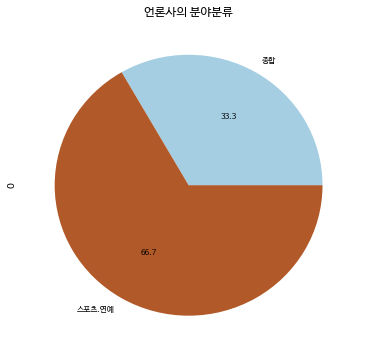

In [24]:
top3cat = list()
for idx in count_by_press[:3].index:
    print ('언론사 : {}, 분야 : {}'.format(idx, cat_press_in_ranked[idx]))
    top3cat.append(cat_press_in_ranked[idx])
top3cat = pd.DataFrame.from_dict(Counter(top3cat), orient='index')[0]
top3cat.plot.pie(autopct='%.1f',colormap = plt.get_cmap('Paired'), fontsize=8, figsize=(6, 6), title='언론사의 분야분류')

* 연합뉴스는 종합, OSEN과 뉴스엔은 스포츠/연예 분야의 언론사이다

> 연합뉴스는 국가 기간 통신사로 전반적인 뉴스를 다루는 기간이라고 들었는데 뉴스1과 뉴시스는?
> * [연합뉴스](http://www.yonhapnews.co.kr/)
>> 연합뉴스(聯合뉴스)는 방송과 신문, 정부, 포털 사이트, 기타 예약 구독자에게 기사를 공급하는 뉴스통신사  
>> 국내외 취재망을 구축해 제작한 기사를 대한민국의 각종 신문사와 방송사와 행정부 각 부처와 주요 기관, 주요 기업체, 인터넷 매체와 국외 계약 매체에도 공급  
>> 정치, 경제, 사회, 문화. 연예, 스포츠, 레저, 과학, 정보, 지방, 외신에 관계된 국내외 뉴스 하루 3천여 건을 제공  
>> 2003년 제정된 「뉴스통신진흥에관한법률」에 의거해 국가 기간 통신사로 지정됐고 국내에 전문 취재 기자 580여 명과 워싱턴, 파리, 모스크바, 도쿄(東京), 베이징(北京)을 위시해 전 세계 30여개 주요 지역에 특파원과 통신원 60여 명을 파견
> * [뉴시스](http://www.newsis.com)
>>  대한민국의 민영 뉴스통신사  
>> 평일 기준으로 하루 평균 약 9000 건의 외신기사와 2700건의 국내 기사와 사진을 생산.  
>> 본사에 150여 명, 지역본부에 150여 명의 취재기자가 속해 있다.  
> * [뉴스1](http://news1.kr)
>> 대한민국의 민영 뉴스통신사  
>> 기사를 전국의 신문과 방송, 정부 부처, 주요 기관, 기업체, 인터넷 포털사이트 등에 공급  
>> 로이터, AFP 등 외국 뉴스통신사와 제휴해 국제 뉴스를 제공  
>> 서울, 부산·경남, 대구·경북, 인천, 광주·전남, 대전·충남, 울산, 경기, 강원, 충북·세종, 전북, 제주 등 전국 광역시·도 17개 지역에 취재본부 네트워크를 구축해 국내 뉴스도 공급  
* 통신사?
> 독자적인 취재조직을 가지고 수집한 뉴스를 신문사와 방송국에 제공하는 기관
> 대한민국 뉴스 통신사로는 연합뉴스 외에 뉴시스, 뉴스1, 아시아뉴스통신, 포커스뉴스, NSP통신 등  

> 연합뉴스, 뉴스1, 뉴시스는 신문사와 방송국에 뉴스를 신문사와 방송국에 제공하는 기관! 등록된 뉴스가 타 언론사에 비해 많을 수 밖에 없다.

#### 뉴스기사수가 상위 10위내 언론사에 대하여 알아보자

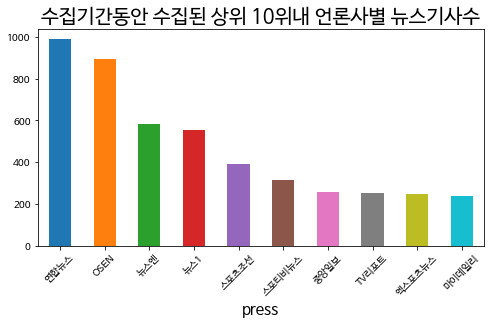

In [25]:
f1 = plt.figure(figsize=(8,4))
plt.title('수집기간동안 수집된 상위 10위내 언론사별 뉴스기사수', color='black', fontsize= 20)
count_by_press[:10].plot(kind='bar', rot=45,ax = f1.gca())
plt.xticks(fontsize=10)
plt.yticks(fontsize=10)
plt.xlabel('press',fontsize=15)
plt.show()

In [26]:
print ('수집기간동안 상위 10위이내 언론사의 뉴스기사 비율 : {:0.2f}'.format(count_by_press[:10].sum()/count_by_press.sum()))

수집기간동안 상위 10위이내 언론사의 뉴스기사 비율 : 0.50


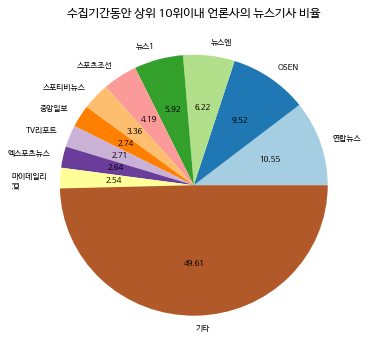

In [27]:
top10 = count_by_press[:10]
top10['기타'] = count_by_press.sum()-count_by_press[:10].sum()
top10.plot.pie(autopct='%.2f',colormap = plt.get_cmap('Paired'), fontsize=8, figsize=(6, 6), title = '수집기간동안 상위 10위이내 언론사의 뉴스기사 비율')

언론사 : 연합뉴스, 분야 : 종합
언론사 : OSEN, 분야 : 스포츠.연예
언론사 : 뉴스엔, 분야 : 스포츠.연예
언론사 : 뉴스1, 분야 : 종합
언론사 : 스포츠조선, 분야 : 스포츠.연예
언론사 : 스포티비뉴스, 분야 : 스포츠 전문지
언론사 : 중앙일보, 분야 : 종합
언론사 : TV리포트, 분야 : 스포츠.연예
언론사 : 엑스포츠뉴스, 분야 : 스포츠.연예
언론사 : 마이데일리, 분야 : 스포츠.연예


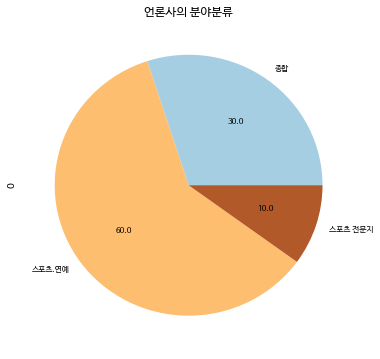

In [28]:
top10cat = list()
for idx in count_by_press[:10].index:
    print ('언론사 : {}, 분야 : {}'.format(idx, cat_press_in_ranked[idx]))
    top10cat.append(cat_press_in_ranked[idx])
top10cat = pd.DataFrame.from_dict(Counter(top10cat), orient='index')[0]
top10cat.plot.pie(autopct='%.1f',colormap = plt.get_cmap('Paired'), fontsize=8, figsize=(6, 6),title='언론사의 분야분류')

#### 뉴스기사수가 상위 20위내 언론사에 대하여 알아보자

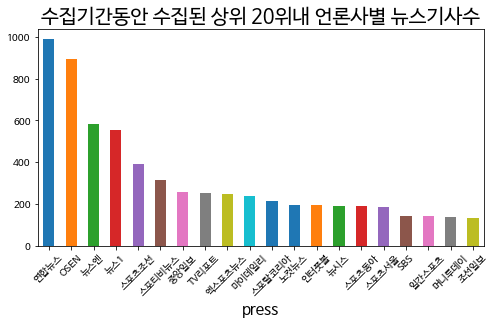

In [29]:
f1 = plt.figure(figsize=(8,4))
plt.title('수집기간동안 수집된 상위 20위내 언론사별 뉴스기사수', color='black', fontsize= 20)
count_by_press[:20].plot(kind='bar', rot=45,ax = f1.gca())
plt.xticks(fontsize=10)
plt.yticks(fontsize=10)
plt.xlabel('press',fontsize=15)
plt.show()

In [30]:
print ('수집기간동안 상위 20위이내 언론사의 뉴스기사 비율 : {:0.2f}'.format(count_by_press[:20].sum()/count_by_press.sum()))

수집기간동안 상위 20위이내 언론사의 뉴스기사 비율 : 0.69


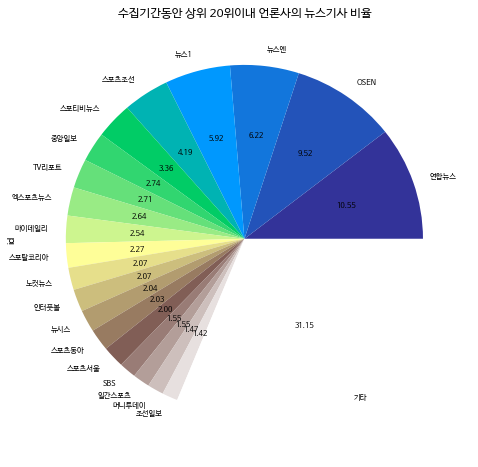

In [31]:
top20 = count_by_press[:20]
top20['기타'] = count_by_press.sum()-count_by_press[:20].sum()
top20.plot.pie(autopct='%.2f', fontsize=7.5, figsize=(8, 8),colormap = plt.get_cmap('terrain'), title = '수집기간동안 상위 20위이내 언론사의 뉴스기사 비율')

언론사 : 연합뉴스, 분야 : 종합
언론사 : OSEN, 분야 : 스포츠.연예
언론사 : 뉴스엔, 분야 : 스포츠.연예
언론사 : 뉴스1, 분야 : 종합
언론사 : 스포츠조선, 분야 : 스포츠.연예
언론사 : 스포티비뉴스, 분야 : 스포츠 전문지
언론사 : 중앙일보, 분야 : 종합
언론사 : TV리포트, 분야 : 스포츠.연예
언론사 : 엑스포츠뉴스, 분야 : 스포츠.연예
언론사 : 마이데일리, 분야 : 스포츠.연예
언론사 : 스포탈코리아, 분야 : 스포츠 전문지
언론사 : 노컷뉴스, 분야 : 온라인.인터넷
언론사 : 인터풋볼, 분야 : 스포츠 전문지
언론사 : 뉴시스, 분야 : 종합
언론사 : 스포츠동아, 분야 : 스포츠.연예
언론사 : 스포츠서울, 분야 : 스포츠.연예
언론사 : SBS, 분야 : TV.동영상
언론사 : 일간스포츠, 분야 : 스포츠.연예
언론사 : 머니투데이, 분야 : 경제
언론사 : 조선일보, 분야 : 종합


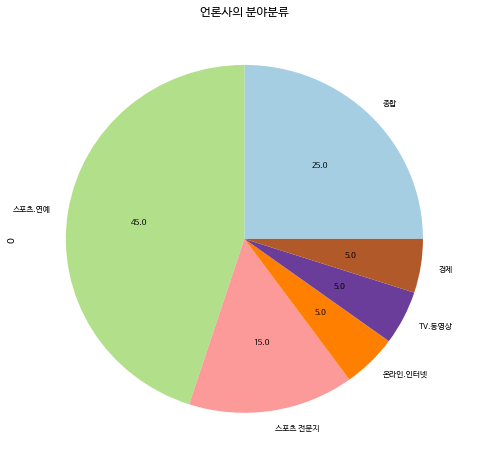

In [32]:
top20cat = list()
for idx in count_by_press[:20].index:
    print ('언론사 : {}, 분야 : {}'.format(idx, cat_press_in_ranked[idx]))
    top20cat.append(cat_press_in_ranked[idx])
top20cat = pd.DataFrame.from_dict(Counter(top20cat), orient='index')[0]
top20cat.plot.pie(autopct='%.1f',colormap = plt.get_cmap('Paired'), fontsize=8, figsize=(8, 8),title='언론사의 분야분류')

### 일별 & 언론별 뉴스기사수

In [33]:
date_press_daum = df_daum.groupby(['date','press'])['id'].count()

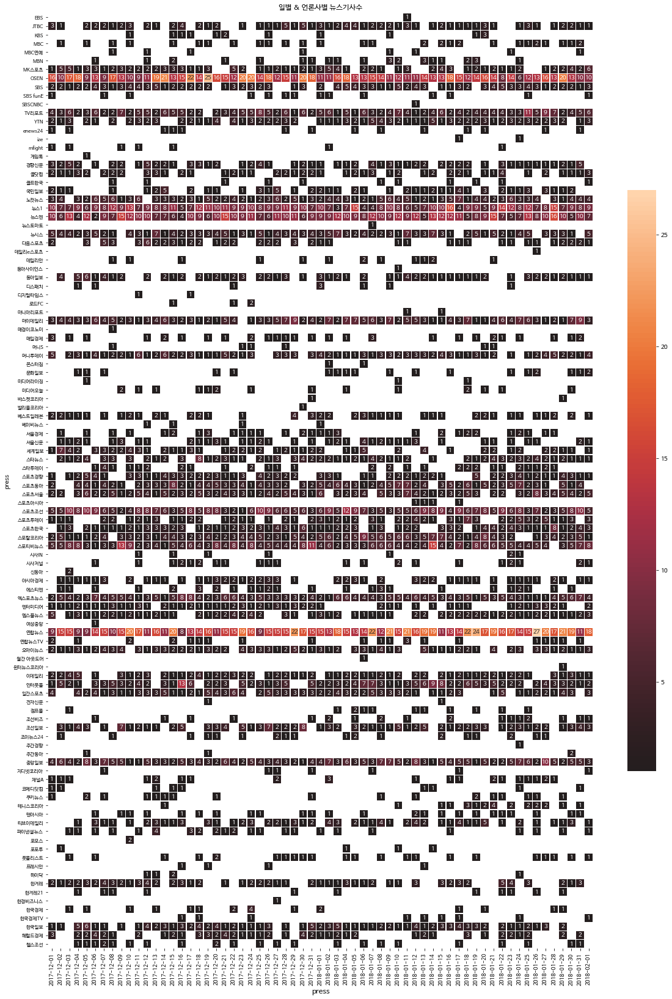

In [37]:
f1 = plt.figure(figsize=(20,35))
plt.title('일별 & 언론사별 뉴스기사수', color='black')
sns.heatmap(date_press_daum.unstack().T, center=0, annot=True,
            square=True, linewidths=.5, cbar_kws={"shrink": .5}, ax=f1.gca())
plt.xticks(fontsize=9)
plt.yticks(fontsize=8)
plt.xlabel('press',fontsize=12)
plt.show()

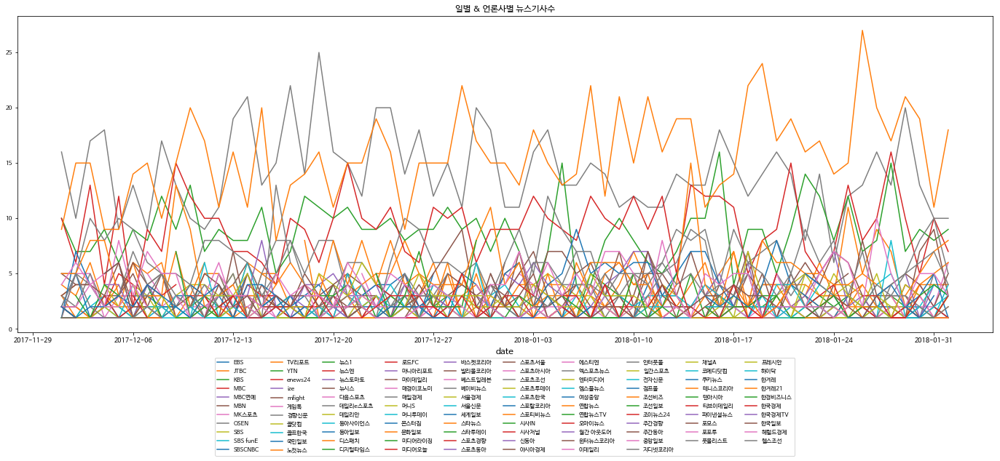

In [38]:
f1 = plt.figure(figsize=(24,8))
plt.title('일별 & 언론사별 뉴스기사수', color='black')
date_press_daum.unstack().plot(kind='line',ax=f1.gca())
plt.legend(loc='lower center',fontsize=8, bbox_to_anchor=(0.5,-0.4),ncol = 10)
plt.xticks(fontsize=9)
plt.yticks(fontsize=8)
plt.xlabel('date',fontsize=12)
plt.show()

#### * 뉴스 수집기간동안 매일 최소 한건의 기사가 랭킹뉴스에 등록된 언론사

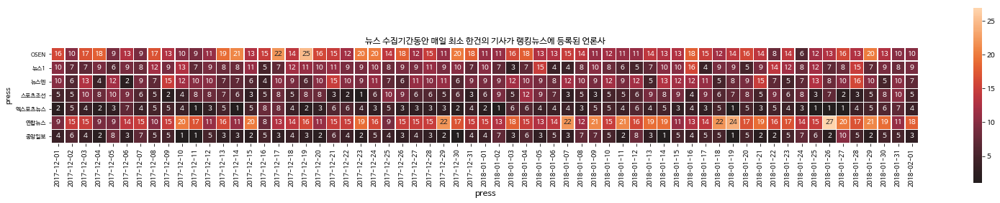

In [39]:
f1 = plt.figure(figsize=(27,9))
plt.title('뉴스 수집기간동안 매일 최소 한건의 기사가 랭킹뉴스에 등록된 언론사', color='black')
sns.heatmap(date_press_daum.unstack().dropna(axis = 1).T, center=0, annot=True,
            square=True, linewidths=.5, cbar_kws={"shrink": .5}, ax=f1.gca())
plt.xticks(fontsize=9)
plt.yticks(fontsize=8)
plt.xlabel('press',fontsize=12)
plt.show()

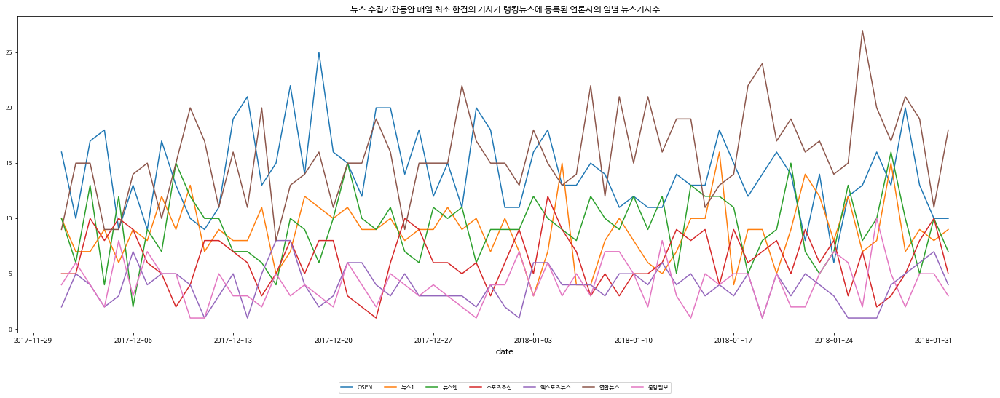

In [41]:
f1 = plt.figure(figsize=(24,8))
plt.title('뉴스 수집기간동안 매일 최소 한건의 기사가 랭킹뉴스에 등록된 언론사의 일별 뉴스기사수', color='black')
date_press_daum.unstack().dropna(axis = 1).plot(kind='line',ax=f1.gca())
plt.legend(loc='lower center',fontsize=8, bbox_to_anchor=(0.5,-0.2),ncol = 10)
plt.xticks(fontsize=9)
plt.yticks(fontsize=8)
plt.xlabel('date',fontsize=12)
plt.show()

언론사 : OSEN, 분야 : 스포츠.연예
언론사 : 뉴스1, 분야 : 종합
언론사 : 뉴스엔, 분야 : 스포츠.연예
언론사 : 스포츠조선, 분야 : 스포츠.연예
언론사 : 엑스포츠뉴스, 분야 : 스포츠.연예
언론사 : 연합뉴스, 분야 : 종합
언론사 : 중앙일보, 분야 : 종합


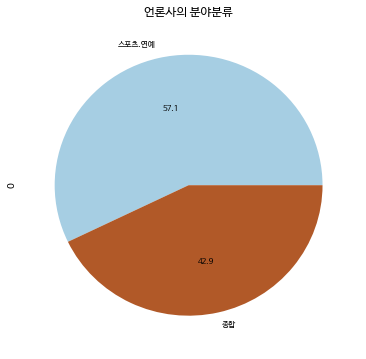

In [42]:
alldaysCat = list()
for idx in date_press_daum.unstack().dropna(axis = 1).columns:
    if idx in cat_press_in_ranked:
        alldaysCat.append(cat_press_in_ranked[idx])
        print ('언론사 : {}, 분야 : {}'.format(idx, cat_press_in_ranked[idx]))    
    else:
        alldaysCat.append('기타')
        print ('언론사 : {}, 분야 : {}'.format(idx, '기타'))    
alldaysCat = pd.DataFrame.from_dict(Counter(alldaysCat), orient='index')[0]
alldaysCat.plot.pie(autopct='%.1f',colormap = plt.get_cmap('Paired'), fontsize=8, figsize=(6, 6), title='언론사의 분야분류')

#### 뉴스량 상위 3, 상위 10, 상위 20 개 언론사를 대상으로 그래프를 그려보자

In [43]:
total_3_press = date_press_daum.unstack().sum(axis = 0).sort_values(ascending=False)[:3].index
total_10_press = date_press_daum.unstack().sum(axis = 0).sort_values(ascending=False)[:10].index
total_20_press = date_press_daum.unstack().sum(axis = 0).sort_values(ascending=False)[:20].index

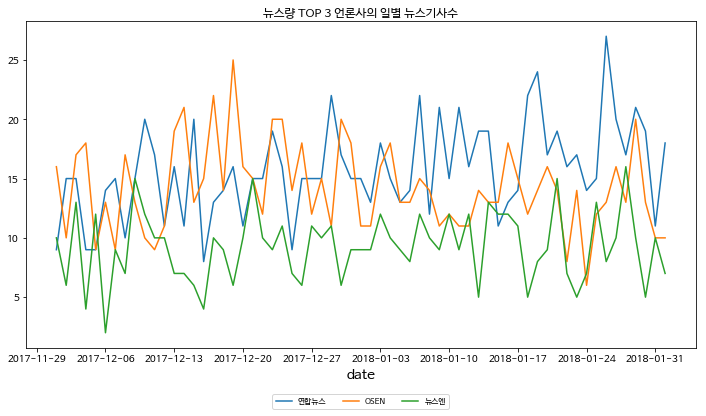

In [44]:
f1 = plt.figure(figsize=(12,6))
plt.title('뉴스량 TOP 3 언론사의 일별 뉴스기사수', color='black')
date_press_daum.unstack().loc[:,total_3_press].plot(kind='line',ax=f1.gca())
plt.legend(loc='lower center',fontsize=8, bbox_to_anchor=(0.5,-0.2),ncol = 10)
plt.xticks(fontsize=10)
plt.yticks(fontsize=10)
plt.xlabel('date',fontsize=14)
plt.show()

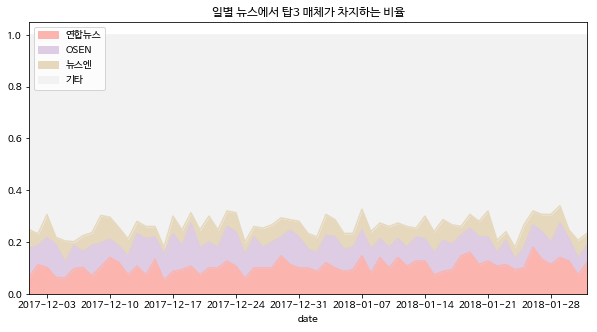

In [45]:
t3p = date_press_daum.unstack().loc[:,total_3_press]
t3p['기타'] = date_press_daum.unstack().sum(axis = 1 ) - t3p.sum(axis = 1)
t3p = t3p.divide(t3p.sum(axis=1), axis=0)
t3p.plot(kind='area',colormap = plt.get_cmap('Pastel1'),figsize=(10,5))
plt.legend(loc='upper left')
plt.margins(0,0)
plt.title('일별 뉴스에서 탑3 매체가 차지하는 비율')
plt.show()

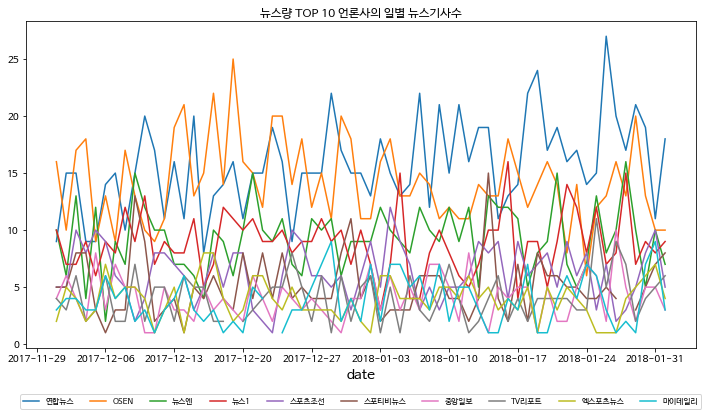

In [46]:
f1 = plt.figure(figsize=(12,6))
plt.title('뉴스량 TOP 10 언론사의 일별 뉴스기사수', color='black')
date_press_daum.unstack().loc[:,total_10_press].plot(kind='line',ax=f1.gca())
plt.legend(loc='lower center',fontsize=8, bbox_to_anchor=(0.5,-0.2),ncol = 10)
plt.xticks(fontsize=10)
plt.yticks(fontsize=10)
plt.xlabel('date',fontsize=14)
plt.show()

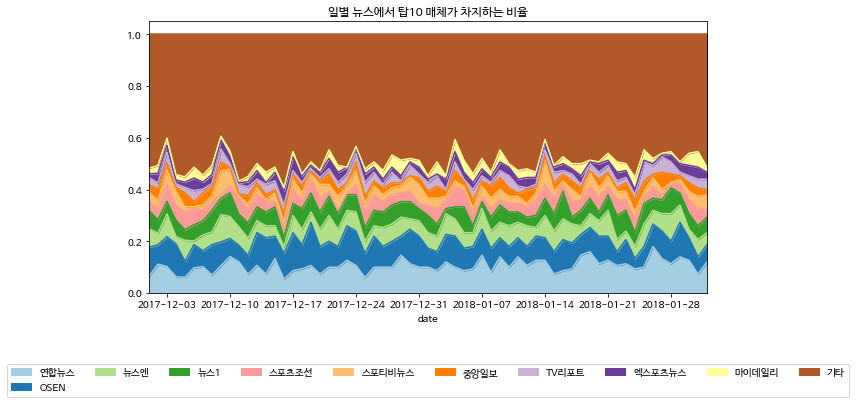

In [47]:
t10p = date_press_daum.unstack().loc[:,total_10_press]
t10p['기타'] = date_press_daum.unstack().sum(axis = 1 ) - t10p.sum(axis = 1)
t10p = t10p.divide(t10p.sum(axis=1), axis=0)
t10p.plot(kind='area',colormap = plt.get_cmap('Paired'),figsize=(10,5))
plt.legend(loc='lower center', bbox_to_anchor=(0.5,-0.4),ncol = 10)
plt.margins(0,0)
plt.title('일별 뉴스에서 탑10 매체가 차지하는 비율')
plt.show()

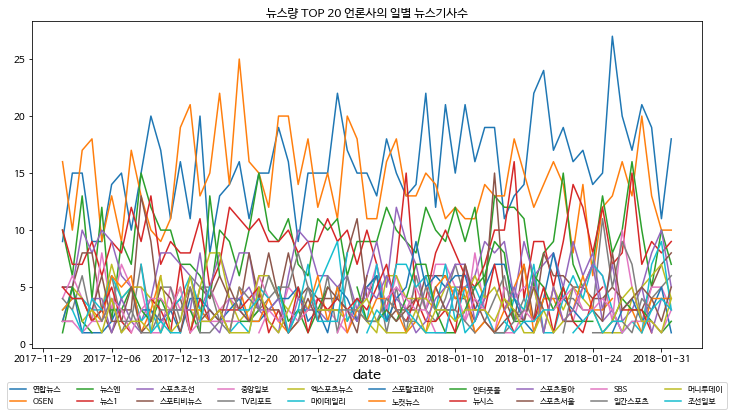

In [48]:
f1 = plt.figure(figsize=(12,6))
plt.title('뉴스량 TOP 20 언론사의 일별 뉴스기사수', color='black')
date_press_daum.unstack().loc[:,total_20_press].plot(kind='line',ax=f1.gca())
plt.legend(loc='lower center',fontsize=8, bbox_to_anchor=(0.5,-0.2),ncol = 10)
plt.xticks(fontsize=10)
plt.yticks(fontsize=10)
plt.xlabel('date',fontsize=14)
plt.show()

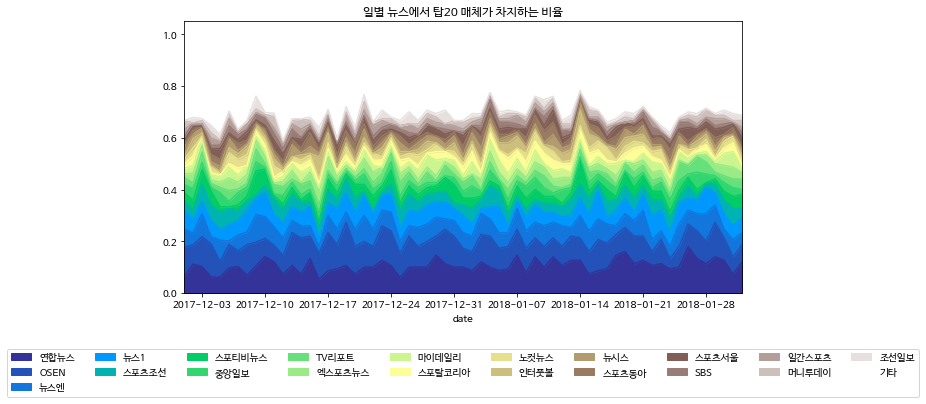

In [49]:
t20p = date_press_daum.unstack().loc[:,total_20_press]
t20p['기타'] = date_press_daum.unstack().sum(axis = 1 ) - t20p.sum(axis = 1)
t20p = t20p.divide(t20p.sum(axis=1), axis=0)
t20p.plot(kind='area',colormap = plt.get_cmap('terrain'),figsize=(10,5))
plt.legend(loc='lower center', bbox_to_anchor=(0.5,-0.4),ncol = 10)
plt.margins(0,0)
plt.title('일별 뉴스에서 탑20 매체가 차지하는 비율')
plt.show()

* 상위 20위까지 언론매체가 일별로 점유율이 평균적으로 0.6 이상인 것으로 판단됨

### 카테고리별 & 언론사별 뉴스기사

In [50]:
category_press_daum = df_daum.groupby(['category','press'])['id'].count()

In [51]:
sortedcpn = category_press_daum.unstack().loc[:,date_press_daum.unstack().sum(axis = 0).sort_values(ascending=False).index]

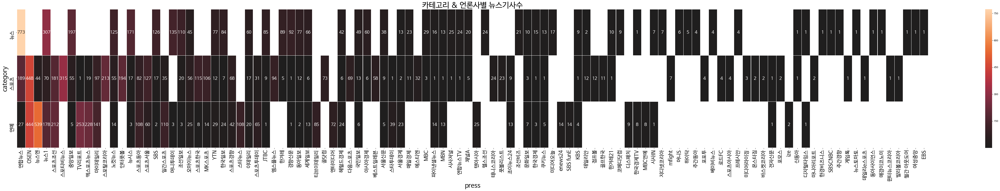

In [52]:
f1 = plt.figure(figsize=(80,10))
plt.title('카테고리 & 언론사별 뉴스기사수', color='black',fontsize=30)
sns.heatmap(sortedcpn, center=0, annot=True, fmt='.0f',annot_kws={"size": 17.5},
            linewidths=.25, cbar_kws={"shrink": 1}, ax=f1.gca())
plt.xticks(fontsize=20)
plt.yticks(fontsize=20)
plt.xlabel('press',fontsize=25)
plt.ylabel('category',fontsize=25)
plt.show()

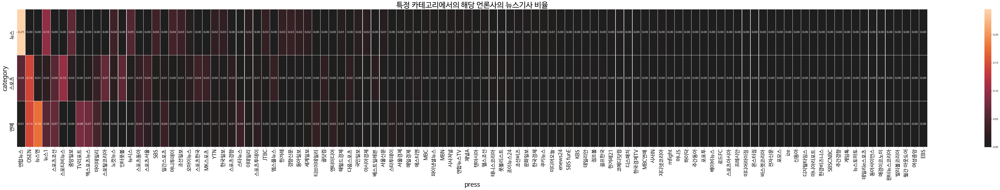

In [53]:
f1 = plt.figure(figsize=(80,10))
plt.title('특정 카테고리에서의 해당 언론사의 뉴스기사 비율', color='black',fontsize=30)
sns.heatmap(sortedcpn.fillna(0).divide(sortedcpn.sum(axis = 1),axis = 0), center=0, annot=True, fmt='.2f',annot_kws={"size": 12},
            linewidths=.25, cbar_kws={"shrink": 1}, ax=f1.gca())
plt.xticks(fontsize=20)
plt.yticks(fontsize=20)
plt.xlabel('press',fontsize=25)
plt.ylabel('category',fontsize=25)
plt.show()

#### * 모든 카테고리(정치, 연예, 스포츠, 세계, 생활/문화, 사회, 경제, IT/과학)에 뉴스 기사가 최소 하나가 있는 언론매체

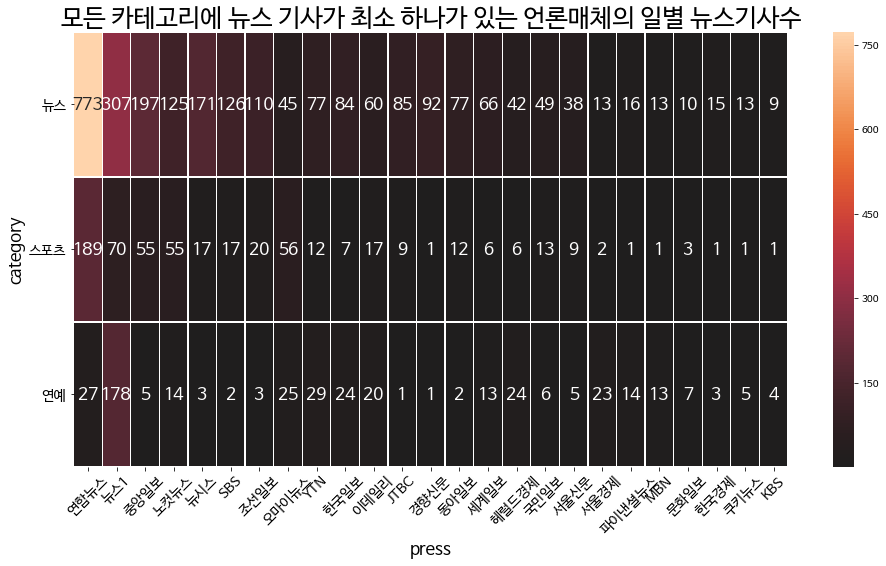

In [54]:
allCatPress = sortedcpn.dropna(axis = 1)
f1 = plt.figure(figsize=(16,8))
plt.title('모든 카테고리에 뉴스 기사가 최소 하나가 있는 언론매체의 일별 뉴스기사수', color='black',fontsize=25)
sns.heatmap(allCatPress, center=0, annot=True, fmt='.0f',annot_kws={"size": 17.5},
            linewidths=.25, cbar_kws={"shrink": 1}, ax=f1.gca())
plt.xticks(fontsize=14,rotation=45)
plt.yticks(fontsize=14,rotation=0)
plt.xlabel('press',fontsize=17)
plt.ylabel('category',fontsize=17)
plt.show()

언론사 : 연합뉴스, 분야 : 종합
언론사 : 뉴스1, 분야 : 종합
언론사 : 중앙일보, 분야 : 종합
언론사 : 노컷뉴스, 분야 : 온라인.인터넷
언론사 : 뉴시스, 분야 : 종합
언론사 : SBS, 분야 : TV.동영상
언론사 : 조선일보, 분야 : 종합
언론사 : 오마이뉴스, 분야 : 온라인.인터넷
언론사 : YTN, 분야 : TV.동영상
언론사 : 한국일보, 분야 : 종합
언론사 : 이데일리, 분야 : 경제
언론사 : JTBC, 분야 : TV.동영상
언론사 : 경향신문, 분야 : 종합
언론사 : 동아일보, 분야 : 종합
언론사 : 세계일보, 분야 : 종합
언론사 : 헤럴드경제, 분야 : 경제
언론사 : 국민일보, 분야 : 종합
언론사 : 서울신문, 분야 : 종합
언론사 : 서울경제, 분야 : 경제
언론사 : 파이낸셜뉴스, 분야 : 경제
언론사 : MBN, 분야 : TV.동영상
언론사 : 문화일보, 분야 : 종합
언론사 : 한국경제, 분야 : 경제
언론사 : 쿠키뉴스, 분야 : 온라인.인터넷
언론사 : KBS, 분야 : TV.동영상


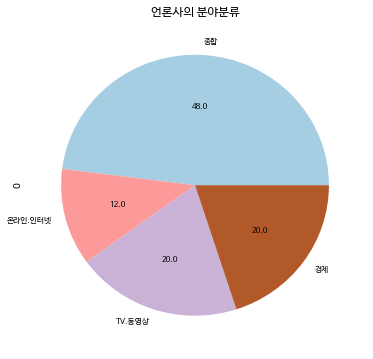

In [55]:
allCat = list()
for idx in allCatPress.columns:
    if idx in cat_press_in_ranked:
        allCat.append(cat_press_in_ranked[idx])
        print ('언론사 : {}, 분야 : {}'.format(idx, cat_press_in_ranked[idx]))    
    else:
        allCat.append('기타')
        print ('언론사 : {}, 분야 : {}'.format(idx, '기타'))    
allCat = pd.DataFrame.from_dict(Counter(allCat), orient='index')[0]
allCat.plot.pie(autopct='%.1f',colormap = plt.get_cmap('Paired'), fontsize=8, figsize=(6, 6), title='언론사의 분야분류')

#### * 모든 카테고리중에서 특정 카테고리에만 뉴스기사가 최소 1개가 나오는 언론매체

In [56]:
pressList = list()
for idx in sortedcpn.columns:
    x = sortedcpn.loc[:,idx]
    if x.isna().sum() == 2:
        pressList.append(idx)
print (len(pressList))

53


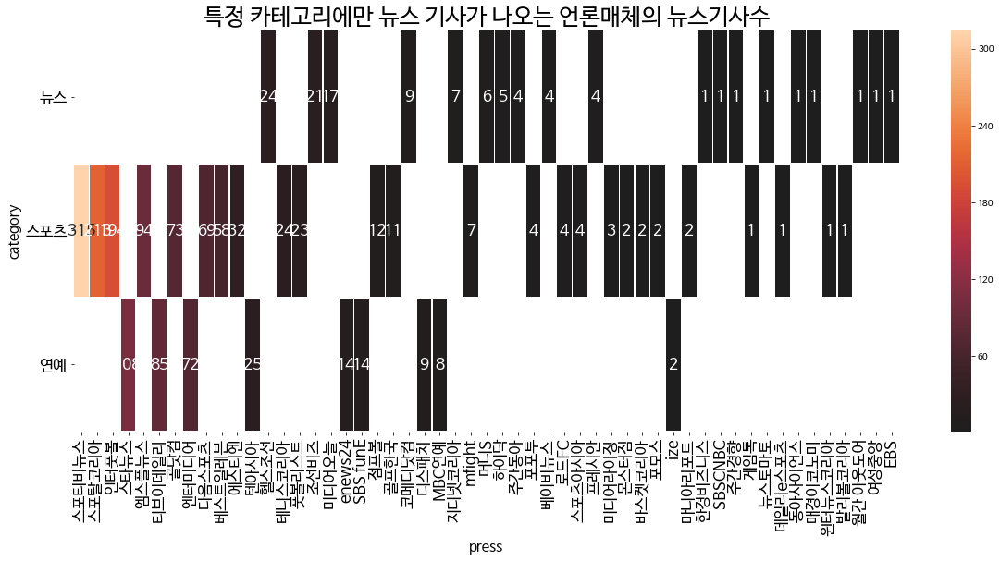

In [57]:
f1 = plt.figure(figsize=(20,8))
plt.title('특정 카테고리에만 뉴스 기사가 나오는 언론매체의 뉴스기사수', color='black',fontsize=25)
sns.heatmap(sortedcpn.loc[:,pressList], center=0, annot=True, fmt='.0f',annot_kws={"size": 17.5},
            linewidths=.25, cbar_kws={"shrink": 1}, ax=f1.gca())
plt.xticks(fontsize=17)
plt.yticks(fontsize=17,rotation=0)
plt.xlabel('press',fontsize=15)
plt.ylabel('category',fontsize=15)
plt.show()

언론사 : 스포티비뉴스, 분야 : 스포츠 전문지
언론사 : 스포탈코리아, 분야 : 스포츠 전문지
언론사 : 인터풋볼, 분야 : 스포츠 전문지
언론사 : 스타뉴스, 분야 : 스포츠.연예
언론사 : 엠스플뉴스, 분야 : 스포츠 전문지
언론사 : 티브이데일리, 분야 : 스포츠.연예
언론사 : 골닷컴, 분야 : 스포츠 전문지
언론사 : 엔터미디어, 분야 : 스포츠.연예
언론사 : 다음스포츠, 분야 : 기타
언론사 : 베스트일레븐, 분야 : 스포츠 전문지
언론사 : 에스티엔, 분야 : 스포츠 전문지
언론사 : 텐아시아, 분야 : 스포츠.연예
언론사 : 헬스조선, 분야 : 매거진
언론사 : 테니스코리아, 분야 : 스포츠 전문지
언론사 : 풋볼리스트, 분야 : 스포츠 전문지
언론사 : 조선비즈, 분야 : 경제
언론사 : 미디어오늘, 분야 : 전문지
언론사 : enews24, 분야 : 스포츠.연예
언론사 : SBS funE, 분야 : 스포츠.연예
언론사 : 점프볼, 분야 : 스포츠 전문지
언론사 : 골프한국, 분야 : 스포츠 전문지
언론사 : 코메디닷컴, 분야 : 매거진
언론사 : 디스패치, 분야 : 스포츠.연예
언론사 : MBC연예, 분야 : 스포츠.연예
언론사 : 지디넷코리아, 분야 : IT
언론사 : mfight, 분야 : 스포츠 전문지
언론사 : 머니S, 분야 : 온라인.인터넷
언론사 : 하이닥, 분야 : 매거진
언론사 : 주간동아, 분야 : 매거진
언론사 : 포포투, 분야 : 스포츠 전문지
언론사 : 베이비뉴스, 분야 : 매거진
언론사 : 로드FC, 분야 : 스포츠 전문지
언론사 : 스포츠아시아, 분야 : 스포츠 전문지
언론사 : 프레시안, 분야 : 온라인.인터넷
언론사 : 미디어라이징, 분야 : 스포츠 전문지
언론사 : 몬스터짐, 분야 : 기타
언론사 : 바스켓코리아, 분야 : 스포츠 전문지
언론사 : 포모스, 분야 : 스포츠 전문지
언론사 : ize, 분야 : 스포츠.연예
언론사 : 마니아리포트, 분야 : 스포츠 전문지
언론사 : 한경비즈니스, 분야 : 매거진


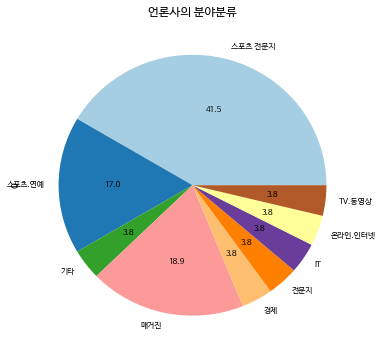

In [58]:
specificCat = list()
for idx in pressList:
    if idx in cat_press_in_ranked:
        specificCat.append(cat_press_in_ranked[idx])
        print ('언론사 : {}, 분야 : {}'.format(idx, cat_press_in_ranked[idx]))    
    else:
        specificCat.append('기타')
        print ('언론사 : {}, 분야 : {}'.format(idx, '기타'))    
specificCat = pd.DataFrame.from_dict(Counter(specificCat), orient='index')[0]
specificCat.plot.pie(autopct='%.1f',colormap = plt.get_cmap('Paired'), fontsize=8, figsize=(6, 6), title='언론사의 분야분류')

#### * 연예 & 스포츠에 특화된 언론매체

In [59]:
sePress = sortedcpn.loc[:,sortedcpn.loc[['스포츠','연예'],:].sum()!=0]
fis= sePress.loc[:,sePress.loc[sePress.index.difference(['스포츠','연예']),:].sum(axis = 0) <=1]
fis.columns

Index(['OSEN', '뉴스엔', '스포츠조선', '스포티비뉴스', 'TV리포트', '엑스포츠뉴스', '마이데일리', '스포탈코리아',
       '인터풋볼', '스포츠동아', '스포츠서울', '일간스포츠', '스포츠한국', 'MK스포츠', '스포츠경향', '스타뉴스',
       '스포츠투데이', '엠스플뉴스', '티브이데일리', '골닷컴', '엔터미디어', '다음스포츠', '베스트일레븐', '스타투데이',
       '에스티엔', '텐아시아', '테니스코리아', '풋볼리스트', '조이뉴스24', 'enews24', 'SBS funE',
       '점프볼', '골프한국', '디스패치', '한국경제TV', 'MBC연예', 'mfight', '포포투', '로드FC',
       '스포츠아시아', '미디어라이징', '몬스터짐', '바스켓코리아', '전자신문', '포모스', 'ize', '신동아',
       '디지털타임스', '마니아리포트', '게임톡', '데일리e스포츠', '윈터뉴스코리아', '발리볼코리아'],
      dtype='object', name='press')

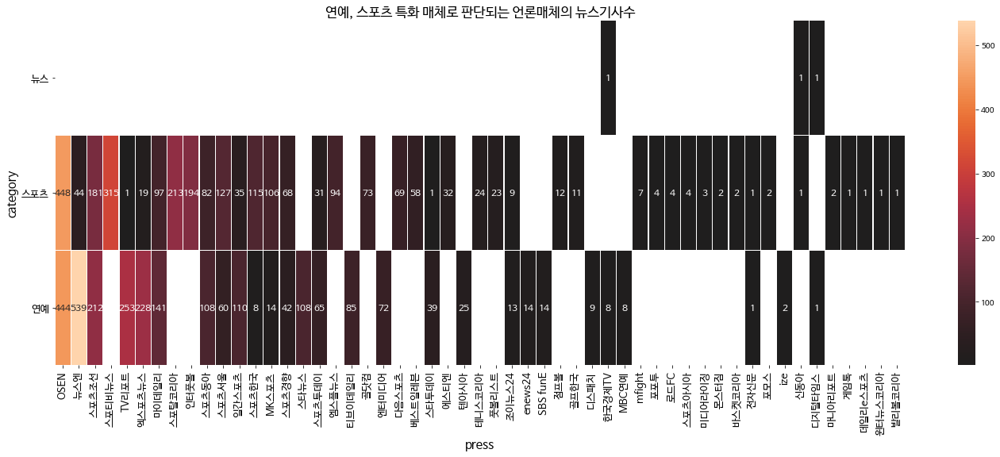

In [60]:
f1 = plt.figure(figsize=(24,8))
plt.title('연예, 스포츠 특화 매체로 판단되는 언론매체의 뉴스기사수', color='black',fontsize=17)
sns.heatmap(sortedcpn.loc[:,fis.columns], center=0, annot=True, fmt='.0f',annot_kws={"size": 12},
            linewidths=.25, cbar_kws={"shrink": 1}, ax=f1.gca())
plt.xticks(fontsize=13)
plt.yticks(fontsize=13,rotation=0)
plt.xlabel('press',fontsize=15)
plt.ylabel('category',fontsize=15)
plt.show()

언론사 : OSEN, 분야 : 스포츠.연예
언론사 : 뉴스엔, 분야 : 스포츠.연예
언론사 : 스포츠조선, 분야 : 스포츠.연예
언론사 : 스포티비뉴스, 분야 : 스포츠 전문지
언론사 : TV리포트, 분야 : 스포츠.연예
언론사 : 엑스포츠뉴스, 분야 : 스포츠.연예
언론사 : 마이데일리, 분야 : 스포츠.연예
언론사 : 스포탈코리아, 분야 : 스포츠 전문지
언론사 : 인터풋볼, 분야 : 스포츠 전문지
언론사 : 스포츠동아, 분야 : 스포츠.연예
언론사 : 스포츠서울, 분야 : 스포츠.연예
언론사 : 일간스포츠, 분야 : 스포츠.연예
언론사 : 스포츠한국, 분야 : 스포츠.연예
언론사 : MK스포츠, 분야 : 스포츠.연예
언론사 : 스포츠경향, 분야 : 스포츠.연예
언론사 : 스타뉴스, 분야 : 스포츠.연예
언론사 : 스포츠투데이, 분야 : 스포츠.연예
언론사 : 엠스플뉴스, 분야 : 스포츠 전문지
언론사 : 티브이데일리, 분야 : 스포츠.연예
언론사 : 골닷컴, 분야 : 스포츠 전문지
언론사 : 엔터미디어, 분야 : 스포츠.연예
언론사 : 다음스포츠, 분야 : 기타
언론사 : 베스트일레븐, 분야 : 스포츠 전문지
언론사 : 스타투데이, 분야 : 스포츠.연예
언론사 : 에스티엔, 분야 : 스포츠 전문지
언론사 : 텐아시아, 분야 : 스포츠.연예
언론사 : 테니스코리아, 분야 : 스포츠 전문지
언론사 : 풋볼리스트, 분야 : 스포츠 전문지
언론사 : 조이뉴스24, 분야 : 스포츠.연예
언론사 : enews24, 분야 : 스포츠.연예
언론사 : SBS funE, 분야 : 스포츠.연예
언론사 : 점프볼, 분야 : 스포츠 전문지
언론사 : 골프한국, 분야 : 스포츠 전문지
언론사 : 디스패치, 분야 : 스포츠.연예
언론사 : 한국경제TV, 분야 : TV.동영상
언론사 : MBC연예, 분야 : 스포츠.연예
언론사 : mfight, 분야 : 스포츠 전문지
언론사 : 포포투, 분야 : 스포츠 전문지
언론사 : 로드FC, 분야 : 스포츠 전문지
언론사 : 스포츠아시아, 분야

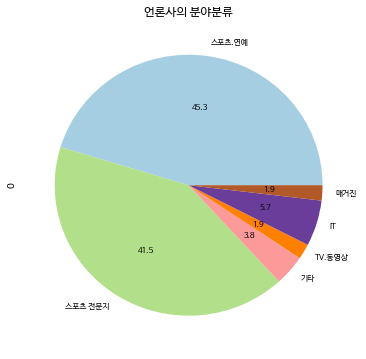

In [61]:
esCat = list()
for idx in fis.columns:
    if idx in cat_press_in_ranked:
        esCat.append(cat_press_in_ranked[idx])
        print ('언론사 : {}, 분야 : {}'.format(idx, cat_press_in_ranked[idx]))    
    else:
        esCat.append('기타')
        print ('언론사 : {}, 분야 : {}'.format(idx, '기타'))    
esCat = pd.DataFrame.from_dict(Counter(esCat), orient='index')[0]
esCat.plot.pie(autopct='%.1f',colormap = plt.get_cmap('Paired'), fontsize=8, figsize=(6, 6), title='언론사의 분야분류')

### 카테고리별로 일별 & 언론사별 뉴스기사

In [62]:
date_category_daum = df_daum.groupby(['category','date','press']).count()['id'].unstack()

#### 카테고리별로 전체가 NaN값인 것은 제외

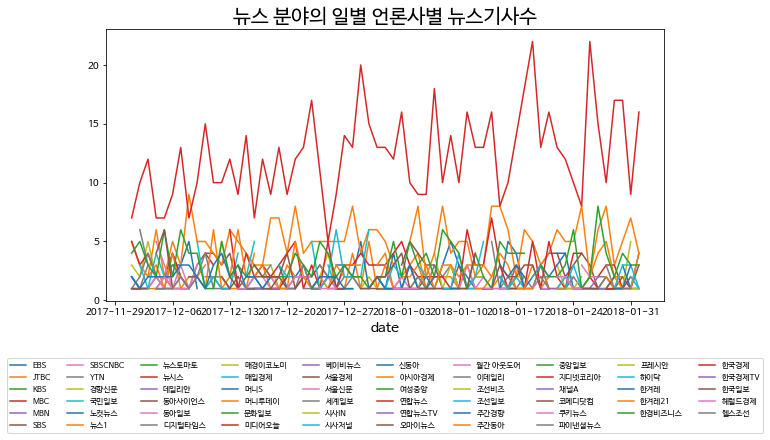

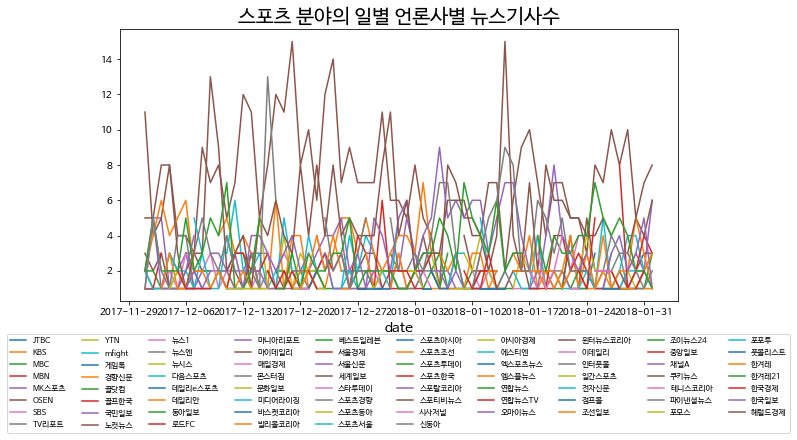

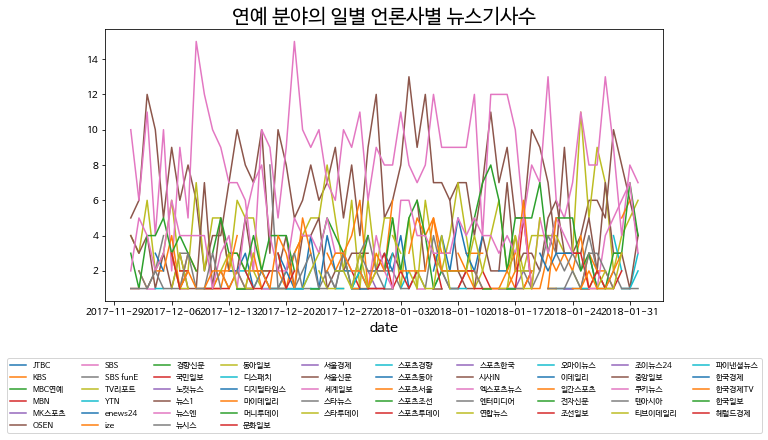

In [63]:
for idx in date_category_daum.index.levels[0]:
    f1 = plt.figure(figsize=(10,5))
    plt.title('{} 분야의 일별 언론사별 뉴스기사수'.format(idx), color='black', fontsize = 20)
    d = date_category_daum.loc[idx,:]
    d.dropna(axis = 1,thresh=1,inplace=True)
    d.plot(kind='line',ax=f1.gca())
    plt.legend(loc='lower center',fontsize=8, bbox_to_anchor=(0.5,-0.5),ncol = 10)
    plt.xticks(fontsize=10)
    plt.yticks(fontsize=10)
    plt.xlabel('date',fontsize=14)
    plt.show()

## 키워드 분석

In [64]:
df_daum= df_daum.sort_values(by='date')

In [65]:
keywordDict = dict()
for idx in df_daum.index:
    idis = df_daum.loc[idx,'id']
    date = df_daum.loc[idx, 'date']
    category= df_daum.loc[idx, 'category']
    if not date in keywordDict:
        keywordDict[date] = dict()
    out1 = keywordDict[date]
    if not category in out1:
        out1[category] = list()
    out2 = out1[category]
    out2.extend(df_daum.loc[idx, 'extracted_keywords'])

In [66]:
from wordcloud import WordCloud
import pytagcloud

/Users/hyunyoun/anaconda3/lib/python3.6/site-packages/matplotlib/pyplot.py:528: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


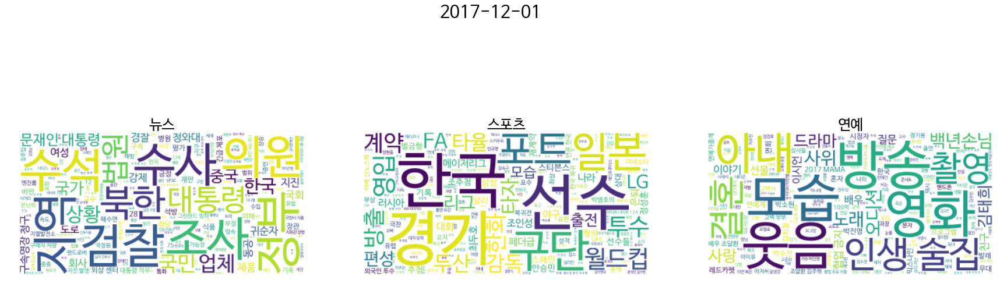

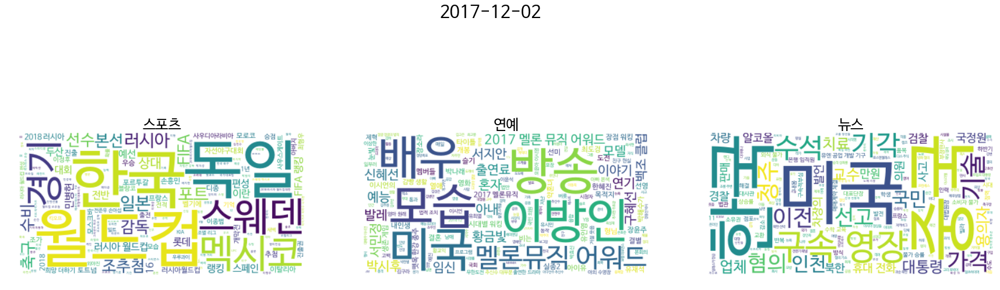

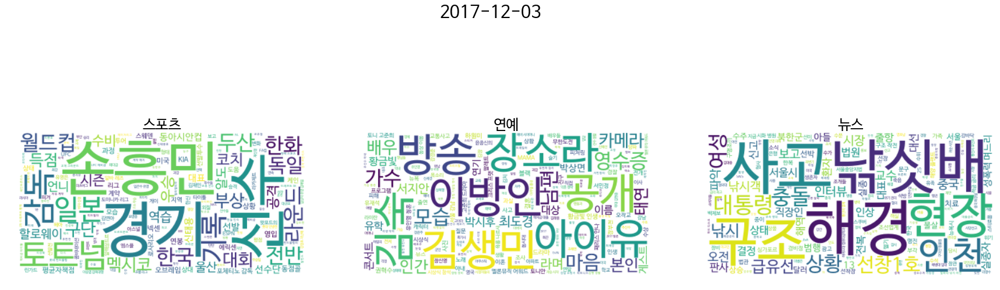

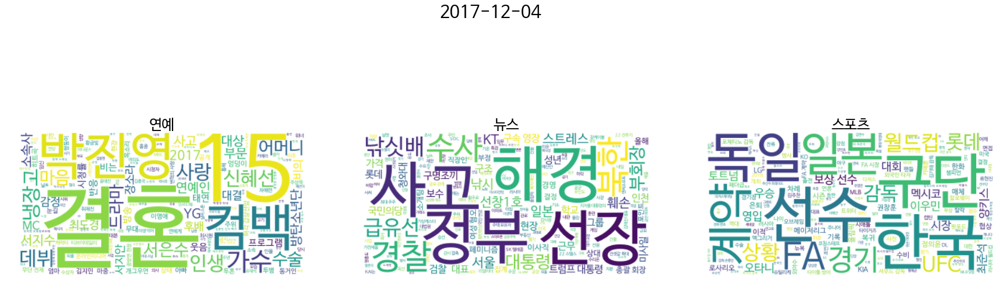

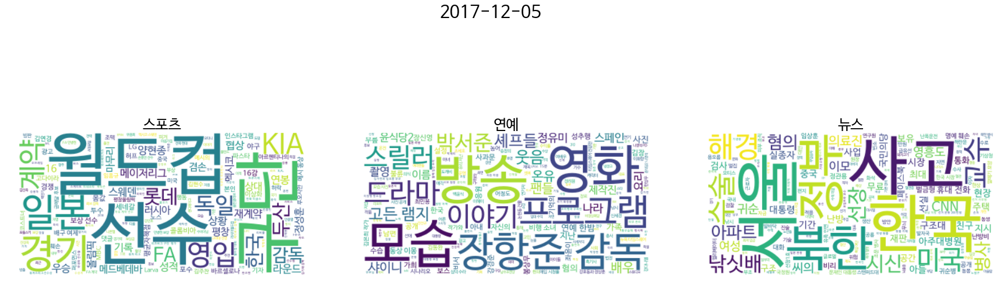

...

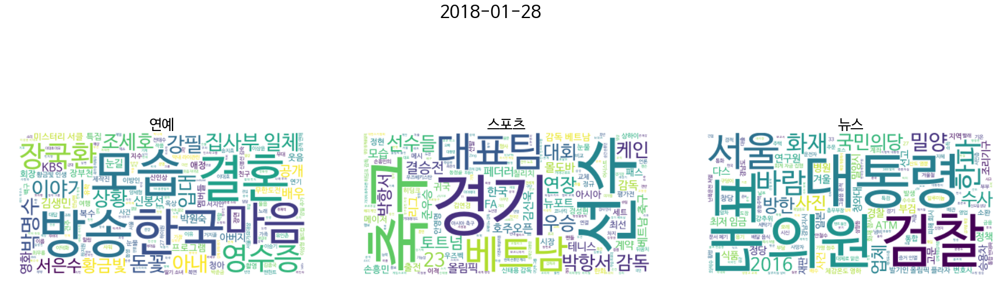

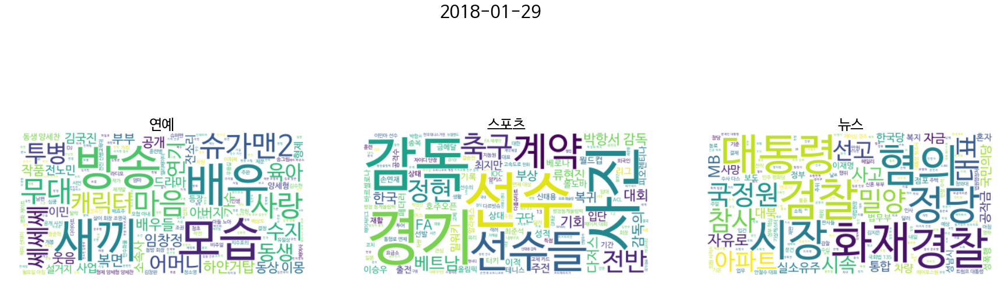

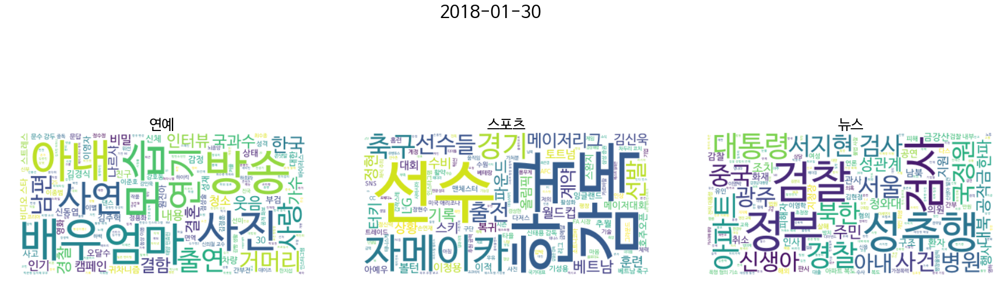

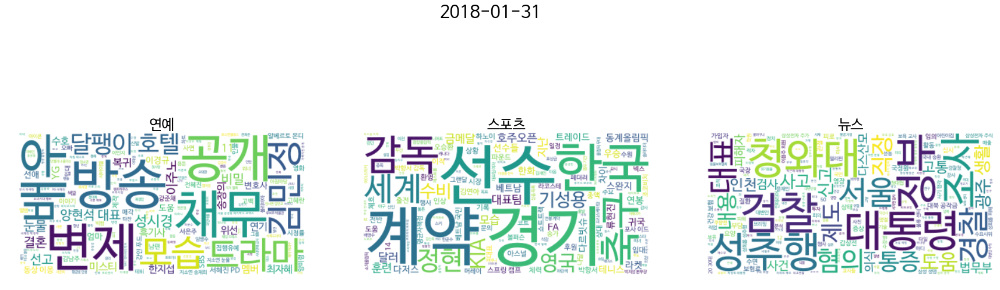

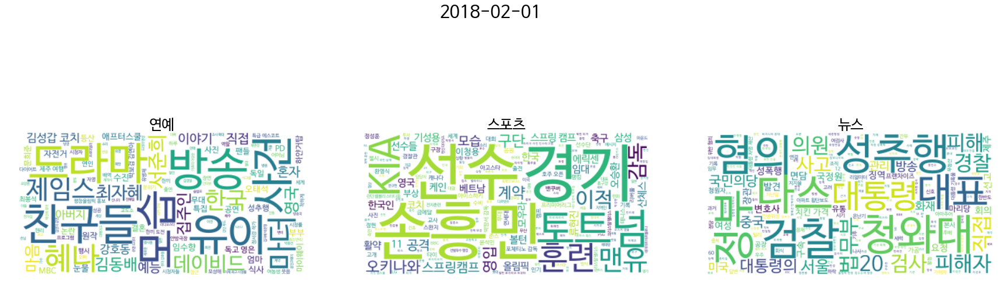

In [67]:
keywordDict2 = dict()
for date in keywordDict:
    xInCat = keywordDict[date]
    fig, axes = plt.subplots(1, len(xInCat),figsize = (30,10))
    fig.suptitle(date, fontsize = 30)
    for idx, cat in enumerate(xInCat):
        x = Counter(xInCat[cat])
        if not cat in keywordDict2:
            keywordDict2[cat] = list()
        keywordDict2[cat].extend(xInCat[cat])
        x1 = WordCloud(relative_scaling=0.05,
                       background_color='white',
                       font_path='/Library/Fonts/NanumBarunGothic.otf').generate_from_frequencies(x)
        axes[idx].imshow(x1, interpolation='bilinear')
        axes[idx].axis('off')
        axes[idx].set_title(cat, fontsize = 25)

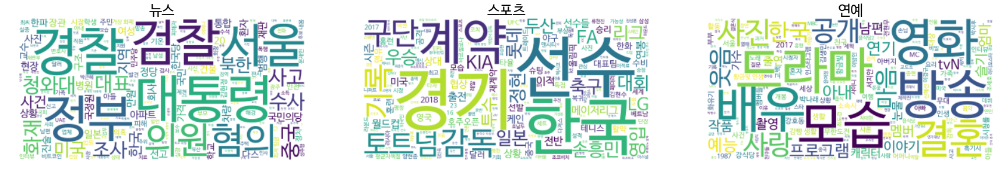

In [68]:
fig, axes = plt.subplots(1, len(xInCat),figsize = (30,10))
for idx, cat in enumerate(keywordDict2):
    xInCat = keywordDict2[cat]
    x = Counter(xInCat)
    x1 = WordCloud(relative_scaling=0.05,
                       background_color='white',
                       font_path='/Library/Fonts/NanumBarunGothic.otf').generate_from_frequencies(x)
    axes[idx].imshow(x1, interpolation='bilinear')
    axes[idx].axis('off')
    axes[idx].set_title(cat, fontsize = 25)

## 댓글수와 키워드 연관 분석

In [69]:
mongodb = dh.ToMongoDB(*dh.AWS_MongoDB_Information())
dbname = 'hy_db'
useDb = dh.Use_Database(mongodb, dbname)
commentsCollection = dh.Use_Collection(useDb, 'comments')

### 일별 정리

In [70]:
group_by_date = df_daum.groupby('date')['number_of_comment', 'number_of_crawled_comment']

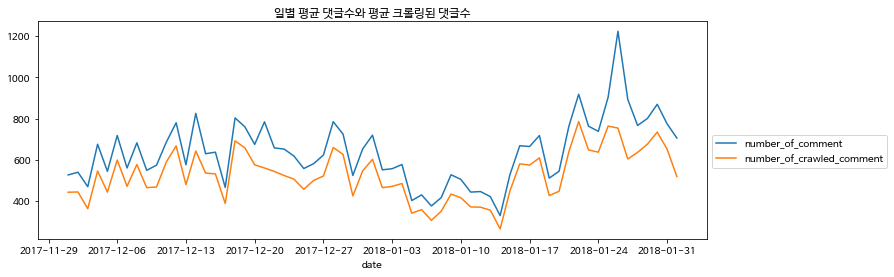

In [71]:
f = plt.figure(figsize=(12,4))
plt.title('일별 평균 댓글수와 평균 크롤링된 댓글수', color='black')
group_by_date.mean().plot(kind='line', ax=f.gca())
plt.legend(loc='best', bbox_to_anchor=(1.0, 0.5))
plt.show()

* 등록된 댓글수와 실제 크롤링된 댓글수가 차이를 보이는 것은 작성자가 삭제하였거나, 스팸신고, 타 사용자의 신고로 삭제된 댓글이 존재하기 때문임

#### 댓글이 제일 많이 달린 날짜 상위 7

In [72]:
def FigureWordcloud(date,keywordDict, category = None):
    if category==None:
        count = Counter(list(itertools.chain.from_iterable(keywordDict[date].values())))
    else:
        count = Counter(keywordDict[date][category])
    makeWordcloud = WordCloud(relative_scaling=0.05,
                       background_color='white',
                       font_path='/Library/Fonts/NanumBarunGothic.otf').generate_from_frequencies(count)
    return count, makeWordcloud

In [73]:
top7Dates = group_by_date.sum()['number_of_comment'].sort_values(ascending = False)[:7]

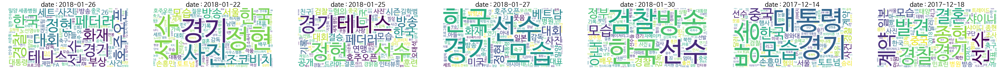

In [74]:
fig, axes = plt.subplots(1, len(top7Dates),figsize = (70,10))
for idx,date in enumerate(top7Dates.index):
    wc = FigureWordcloud(date, keywordDict,category=None)
    date = date.strftime('%Y-%m-%d')
    axes[idx].imshow(wc[1], interpolation='bilinear')
    axes[idx].axis('off')
    axes[idx].set_title('date : {}'.format(date), fontsize = 25)

### 카테고리별 정리

In [75]:
group_by_category = df_daum.groupby('category')['number_of_comment', 'number_of_crawled_comment']

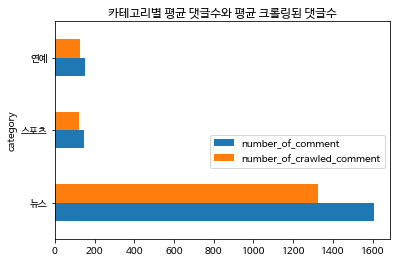

In [76]:
f = plt.figure(figsize=(6,4))
plt.title('카테고리별 평균 댓글수와 평균 크롤링된 댓글수', color='black')
group_by_category.mean().plot.barh( ax=f.gca())
plt.legend(loc='best', bbox_to_anchor=(1.0, 0.5))
plt.show()

In [77]:
fDf = df_daum[['category','number_of_comment', 'number_of_crawled_comment']]

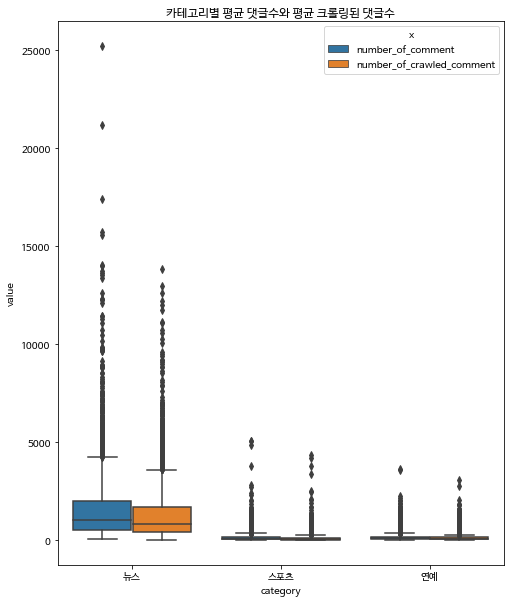

In [78]:
f = plt.figure(figsize=(8,10))
plt.title('카테고리별 평균 댓글수와 평균 크롤링된 댓글수', color='black')
dd = pd.melt(fDf, id_vars = ['category'], value_vars=['number_of_comment', 'number_of_crawled_comment'],var_name='x')
sns.boxplot(x = 'category', y = 'value', data =dd, hue = 'x', ax=f.gca())
plt.show()

### 일별 & 카테고리별 정리

In [79]:
group_by_date_category = df_daum.groupby(['date', 'category'])['number_of_comment', 'number_of_crawled_comment']

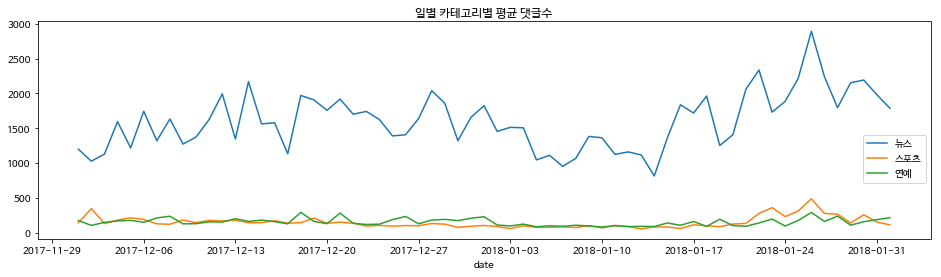

In [80]:
f = plt.figure(figsize=(16,4))
plt.title('일별 카테고리별 평균 댓글수', color='black')
group_by_date_category.mean()['number_of_comment'].unstack().plot(ax=f.gca())
plt.legend(loc='best', bbox_to_anchor=(1.0, 0.5))
plt.show()

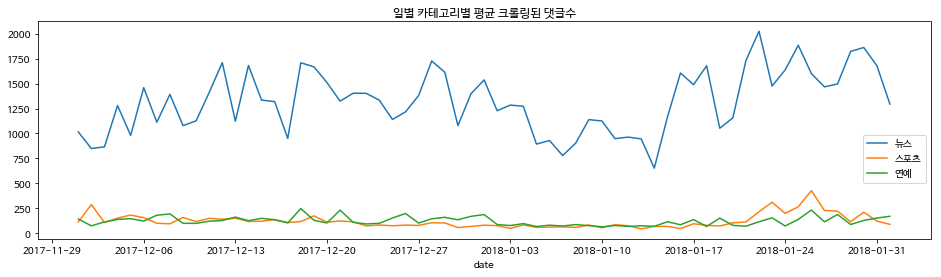

In [81]:
f = plt.figure(figsize=(16,4))
plt.title('일별 카테고리별 평균 크롤링된 댓글수', color='black')
group_by_date_category.mean()['number_of_crawled_comment'].unstack().plot(kind='line', ax=f.gca())
plt.legend(loc='best', bbox_to_anchor=(1.0, 0.5))
plt.show()

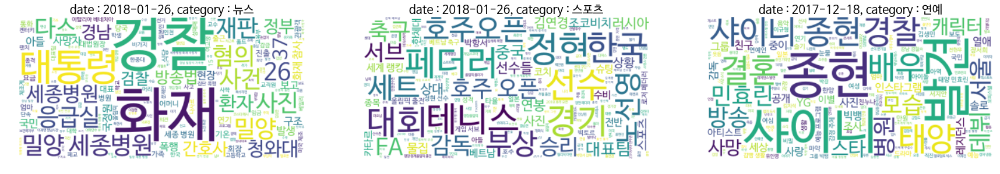

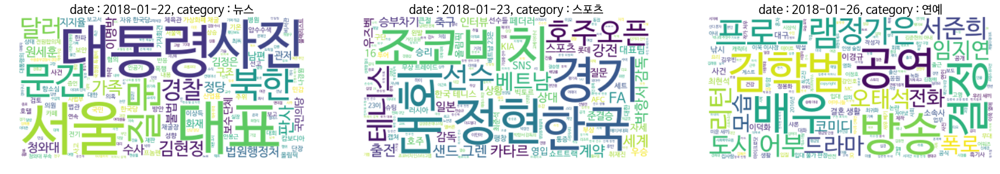

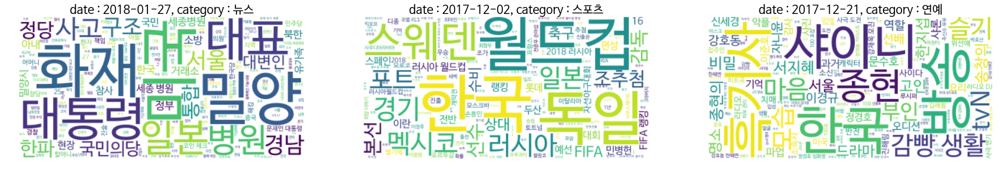

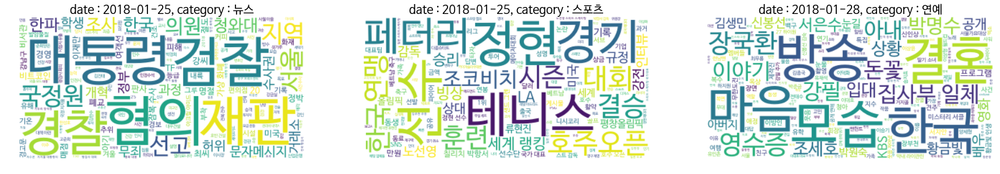

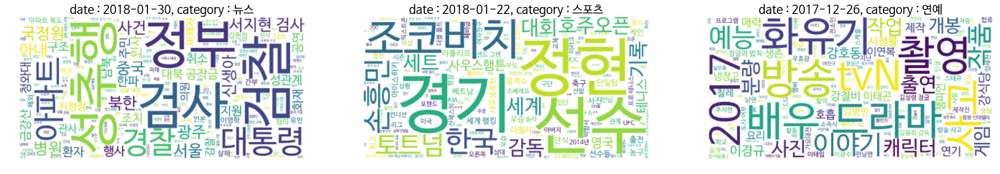

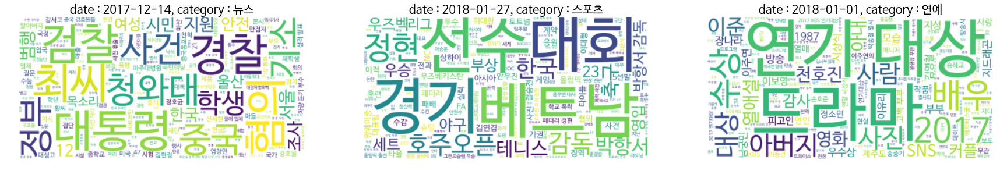

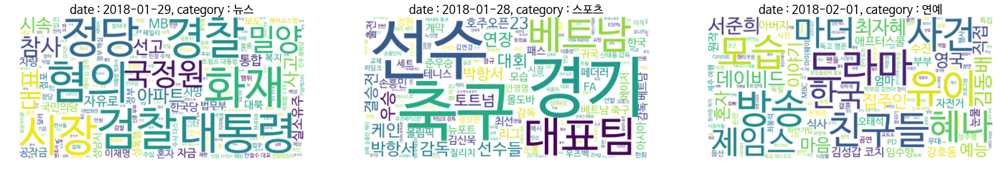

In [82]:
for idx1 in range(7):
    fig, axes = plt.subplots(1, 3, figsize = (30, 10))
    for idx2, column in enumerate(group_by_date_category.sum()['number_of_comment'].unstack().columns):
        date = group_by_date_category.sum()['number_of_comment'].unstack().sort_values(by=column,ascending=False).index[idx1]
        wc = FigureWordcloud(date, keywordDict, column)
        date = date.strftime('%Y-%m-%d')
        axes[idx2].imshow(wc[1], interpolation='bilinear')
        axes[idx2].axis('off')
        axes[idx2].set_title('date : {}, category : {}'.format(date, column), fontsize = 20)